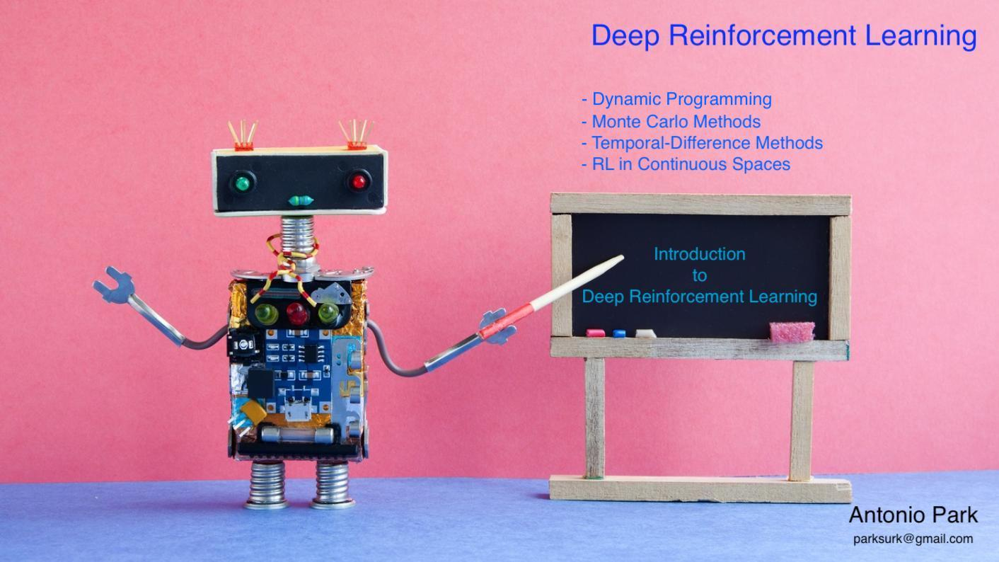

In [1]:
from IPython.display import Image
Image(filename='./images/1-0-0-1_opening.jpg')

# Lesson 1-6: RL in Continuous Spaces

So far, you have worked with reinforcement learning environments where the number of states and actions is limited. With small, finite Markov Decision Processes (MDPs), it is possible to represent the action-value function with a table, dictionary, or other finite structure.

For instance, consider the very small gridworld below. Say the world has four possible states, and the agent has four possible actions at its disposal (up, down, left, right). You learned in the previous lessons that we can represent the estimated optimal action-value function in a table, with a row for each state and a column for each action. We refer to this table as a Q-table.

![Q-Table](./images/1-5-0-0.qtable.png)

But what about MDPs with much larger spaces? Consider that the Q-table must have a row for each state. So, for instance, if there are 10 million possible states, the Q-table must have 10 million rows. Furthermore, if the state space is the set of continuous real-valued numbers (an infinite set!), it becomes impossible to represent the action values in a finite structure!

In this lecture, you will learn how to generalize the tabular solution methods from the previous lessons to work with large and continuous spaces. This will lay the foundation for developing the deep reinforcement learning algorithms that you will explore later in the nanodegree.


## 1-6-1 : Overview of RL framework

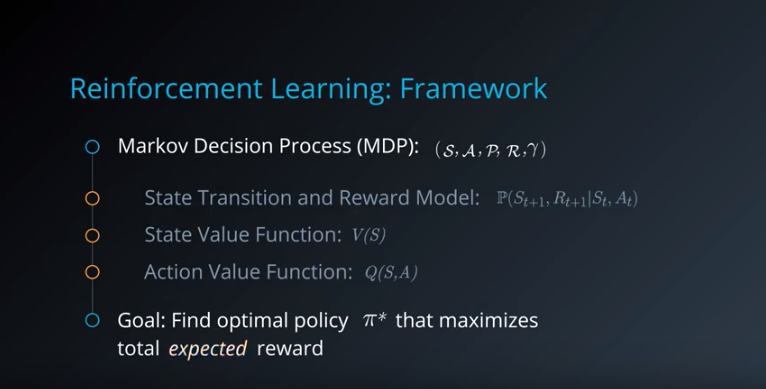

In [2]:
from IPython.display import Image
Image(filename='./images/1-6-1-1_overview_rl_mdp_and_policy.png')

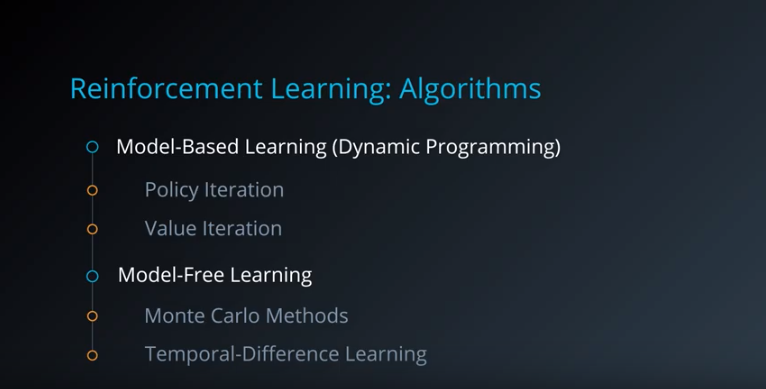

In [3]:
from IPython.display import Image
Image(filename='./images/1-6-1-2_model-based-learning_and_model-free-learning.png')

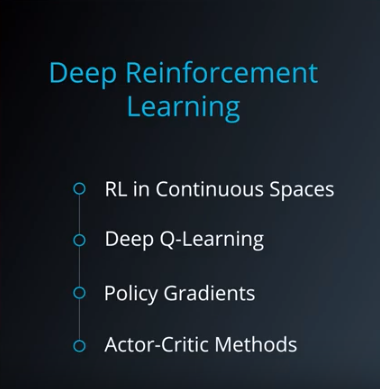

In [4]:
from IPython.display import Image
Image(filename='./images/1-6-1-3_rl-in-continuous-learning_is_a_base_of_drl-algorithms.png')

## 1-6-2 : Discrete vs. Continuous Spaces

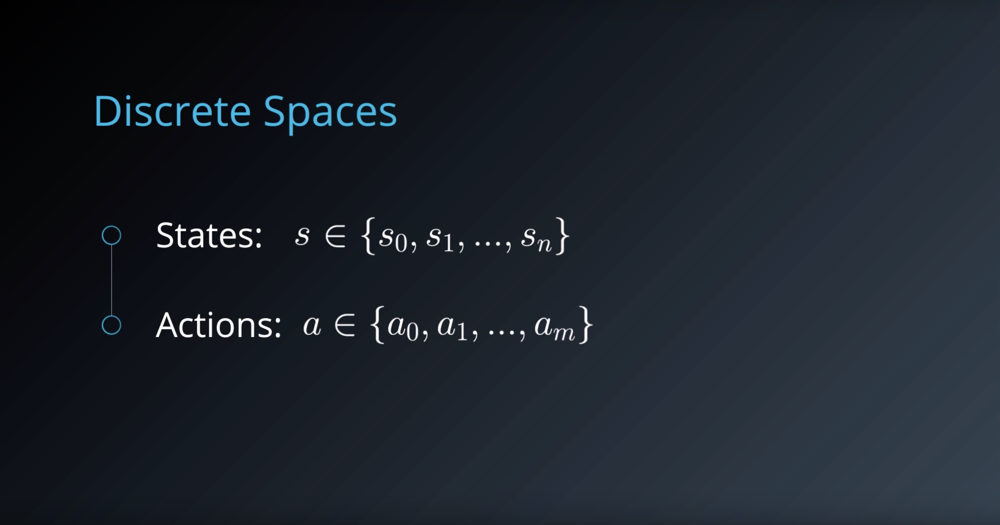

In [5]:
from IPython.display import Image
Image(filename='./images/1-6-2-1_discrete-space.png')

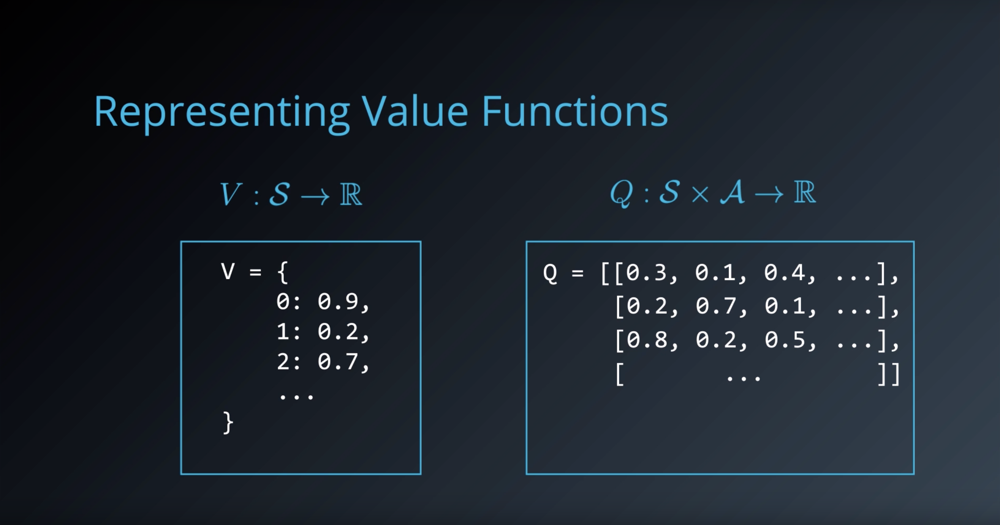

In [6]:
from IPython.display import Image
Image(filename='./images/1-6-2-2_representing_value-functions.png')

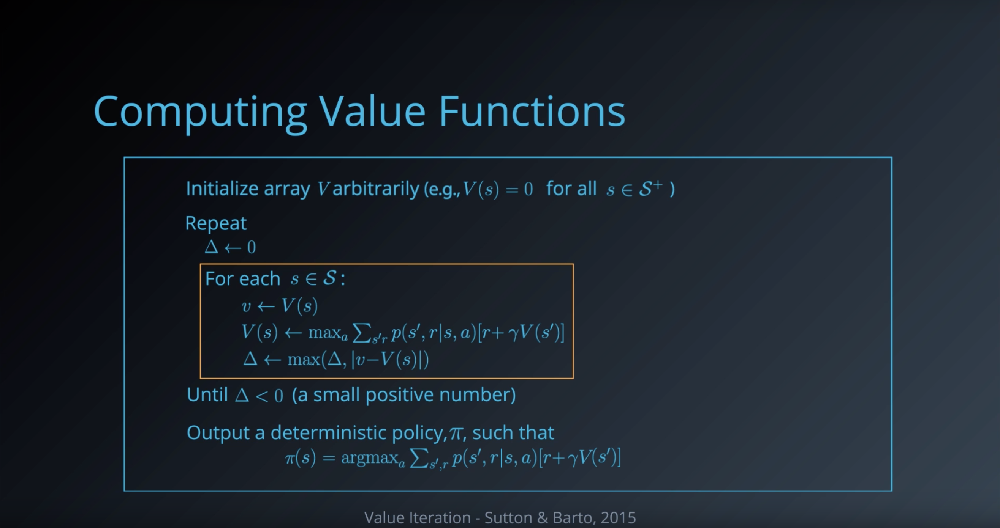

In [7]:
from IPython.display import Image
Image(filename='./images/1-6-2-3_computing_value-functions_value-interation.png')

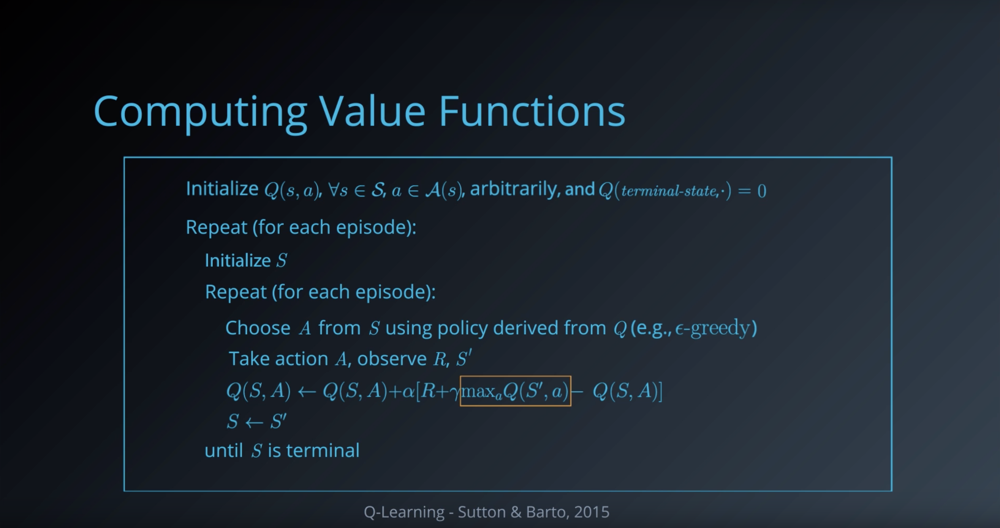

In [8]:
from IPython.display import Image
Image(filename='./images/1-6-2-4_computing_value-functions_q-learning.png')

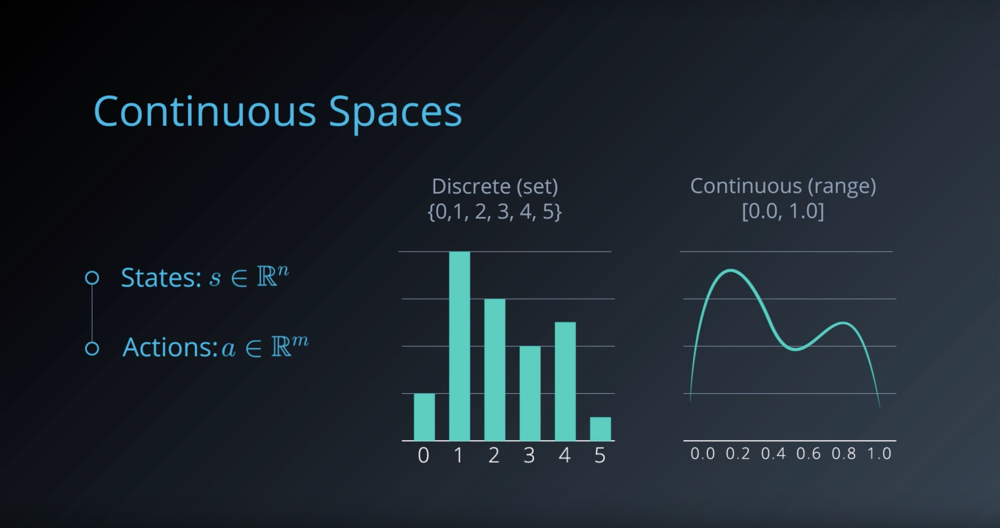

In [9]:
from IPython.display import Image
Image(filename='./images/1-6-2-5_continuous-spaces.png')

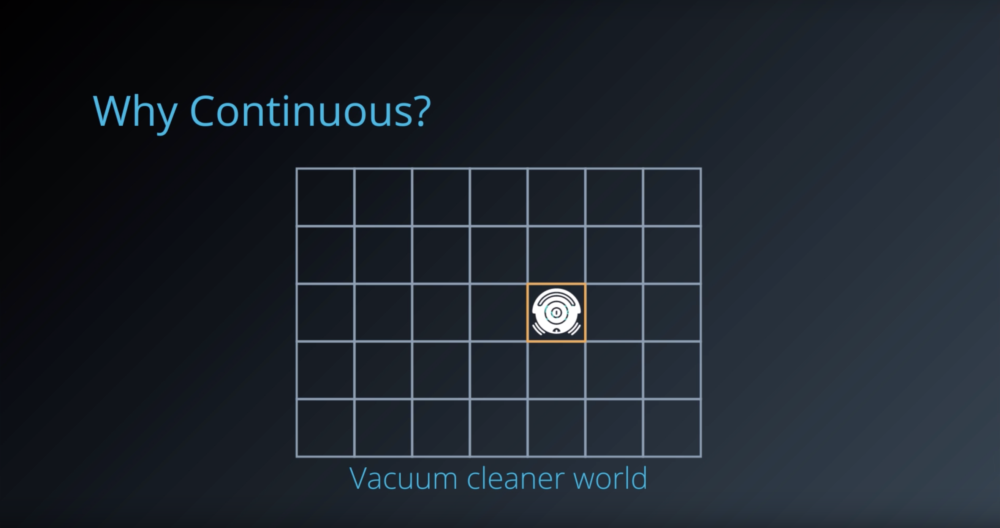

In [10]:
from IPython.display import Image
Image(filename='./images/1-6-2-6_why_continuous_descrete_example_is_easy_to_understand.png')

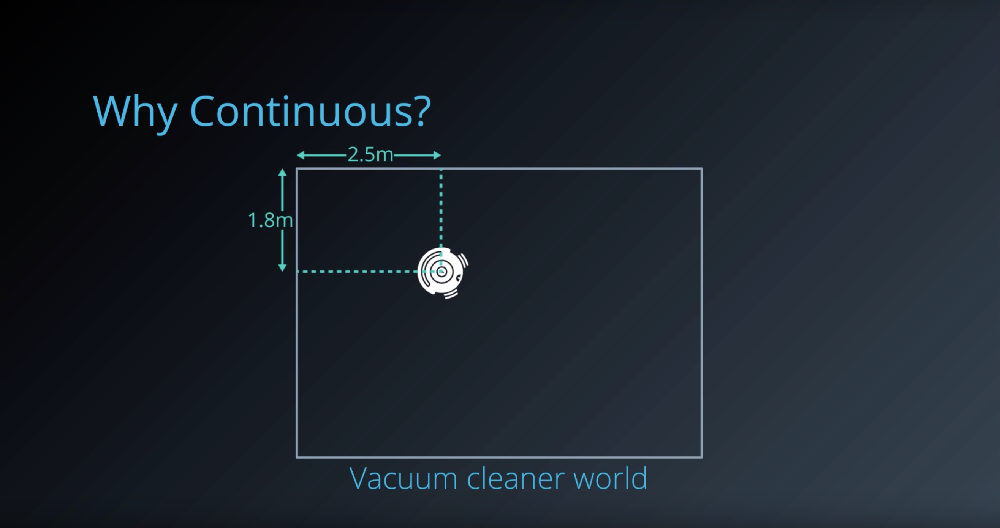

In [11]:
from IPython.display import Image
Image(filename='./images/1-6-2-7_why_continuous_but_real_world_is_continuous.png')

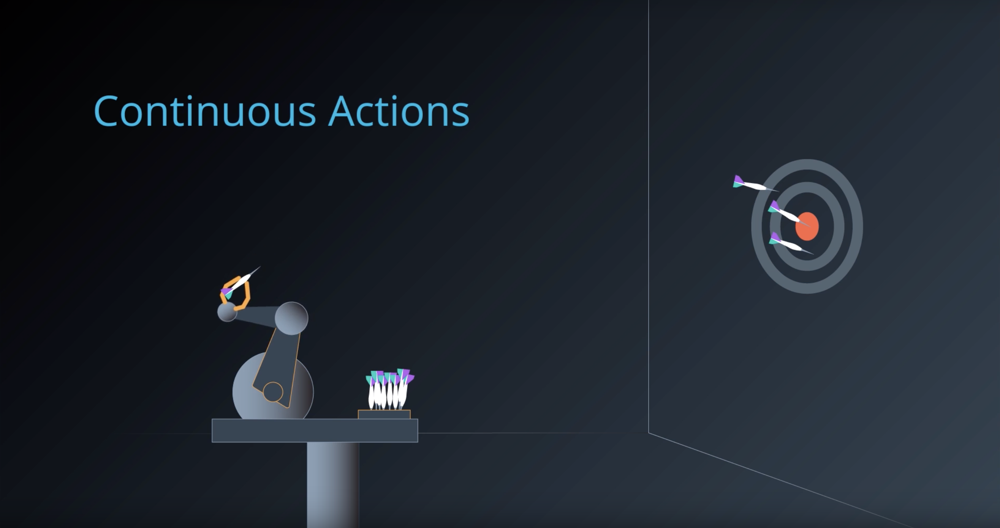

In [12]:
from IPython.display import Image
Image(filename='./images/1-6-2-8_continuous-actions.png')

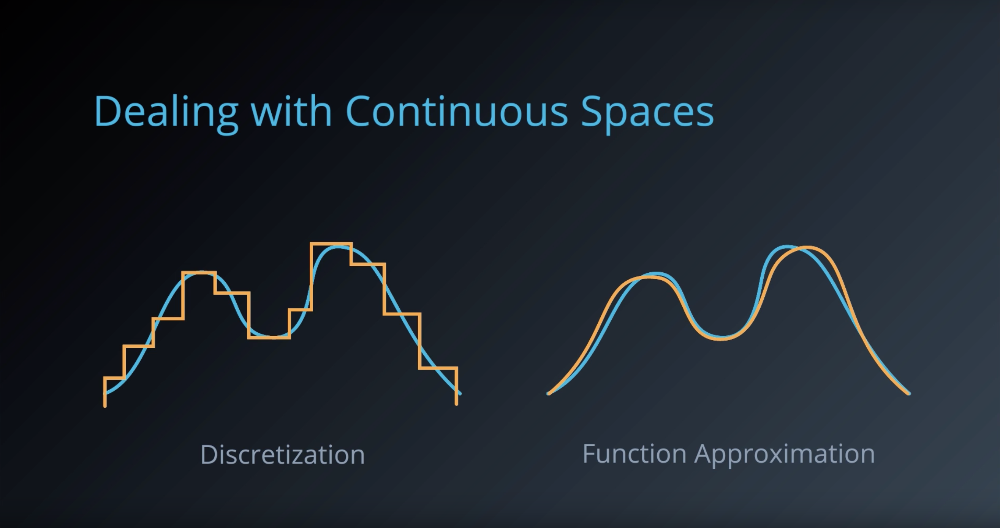

In [13]:
from IPython.display import Image
Image(filename='./images/1-6-2-9_dealing_with_continuous-spaces.png')

## Quiz

Which of the following state or action spaces can be encoded using discrete representations?

1. A hand of cards when playing Poker
2. Force applied when grasping with a robotic arm
3. GPS coordinates for autonomous driving
4. Board positions for a 9x9 Go game
5. Keys to play on a musical keyboard

## 1-6-3. Discretization

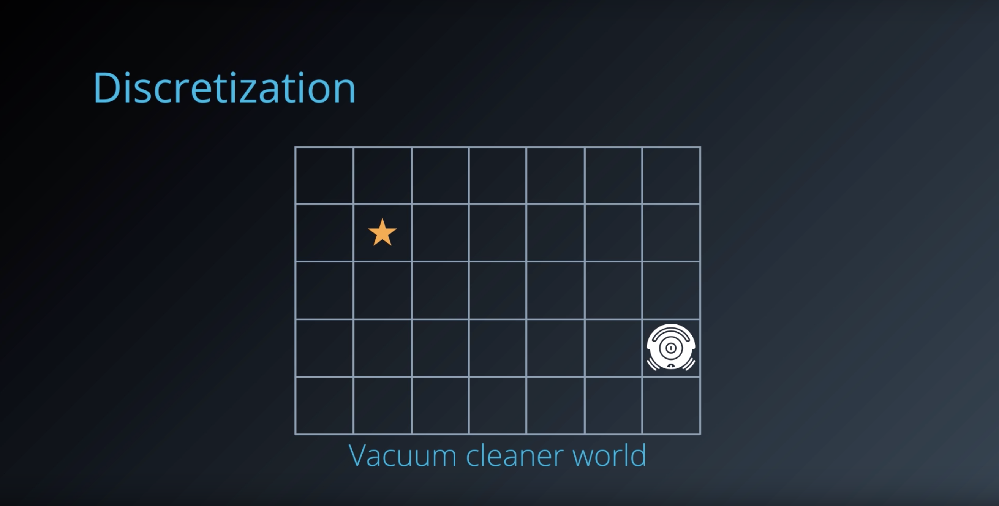

In [15]:
from IPython.display import Image
Image(filename='./images/1-6-3-1_discertization_vacuum-clearner-world.png')

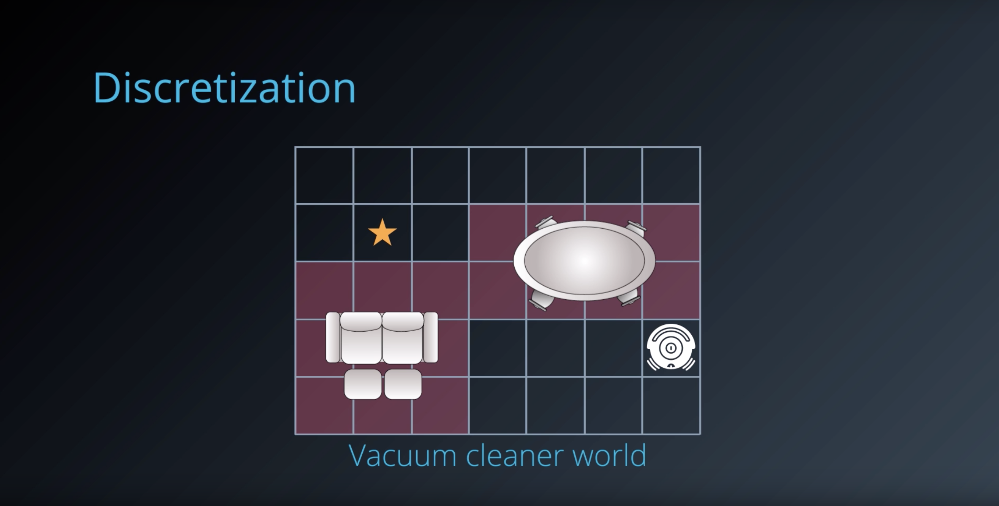

In [16]:
from IPython.display import Image
Image(filename='./images/1-6-3-2_discertization_vacuum-clearner-world_obstacle_with_no_path.png')

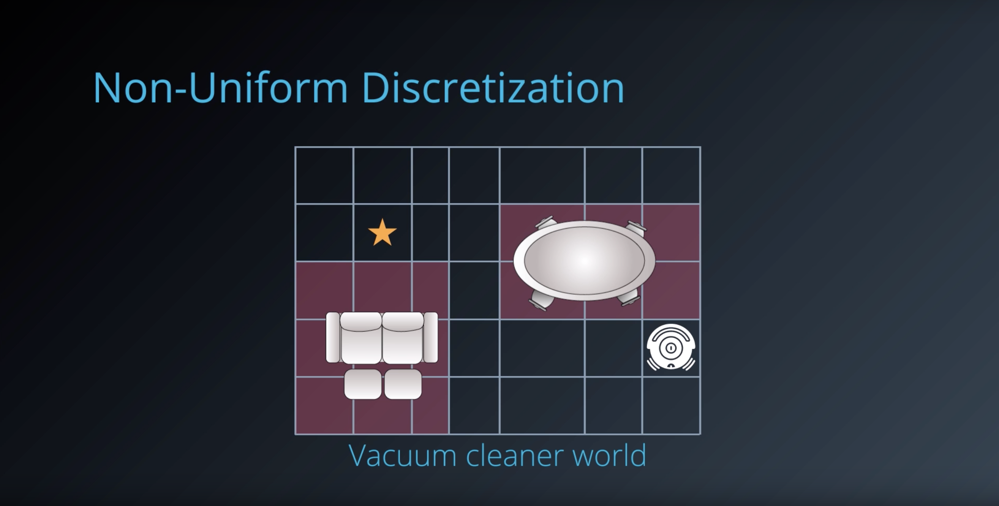

In [17]:
from IPython.display import Image
Image(filename='./images/1-6-3-3_discertization_vacuum-clearner-world_non-uniform-descretization_example_1.png')

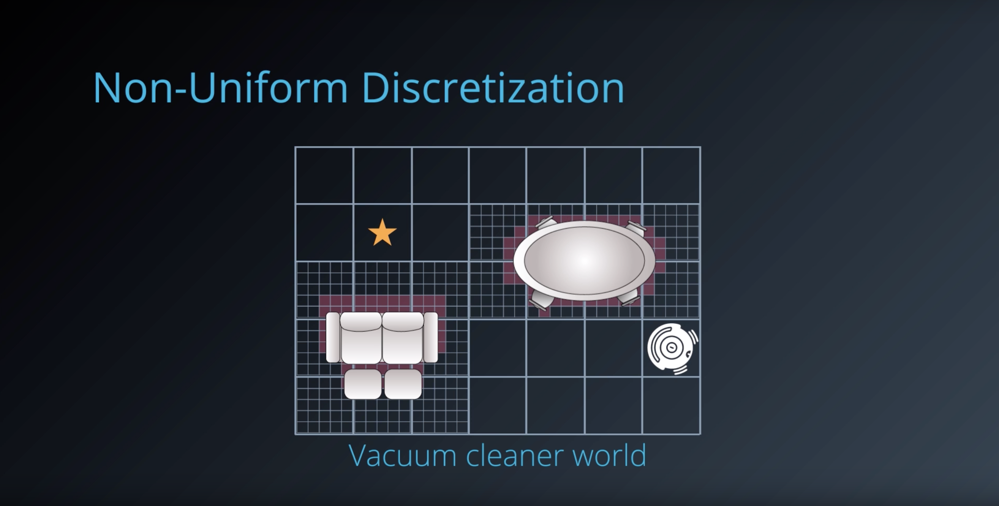

In [18]:
from IPython.display import Image
Image(filename='./images/1-6-3-4_discertization_vacuum-clearner-world_non-uniform-descretization_example_2.png')

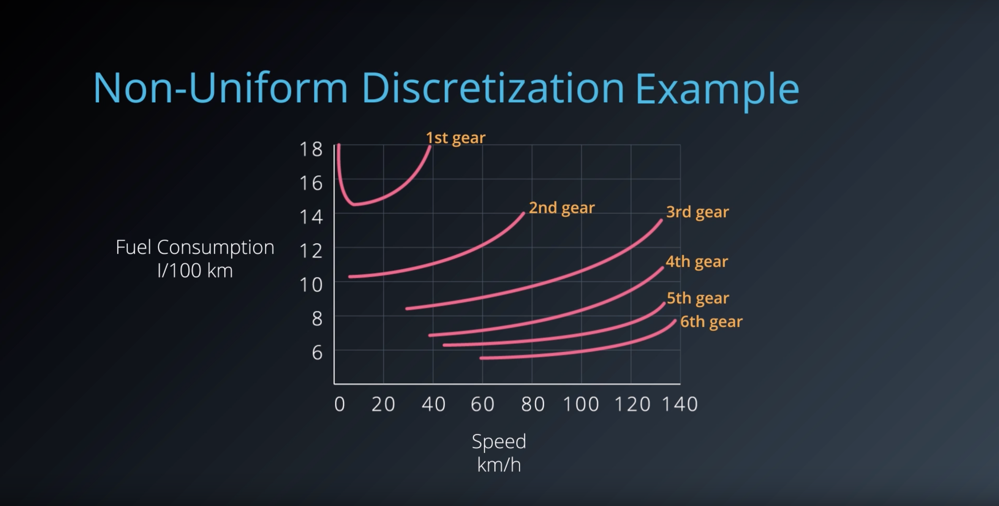

In [19]:
from IPython.display import Image
Image(filename='./images/1-6-3-5_discertization_other_non-uniform-descretization_example.png')

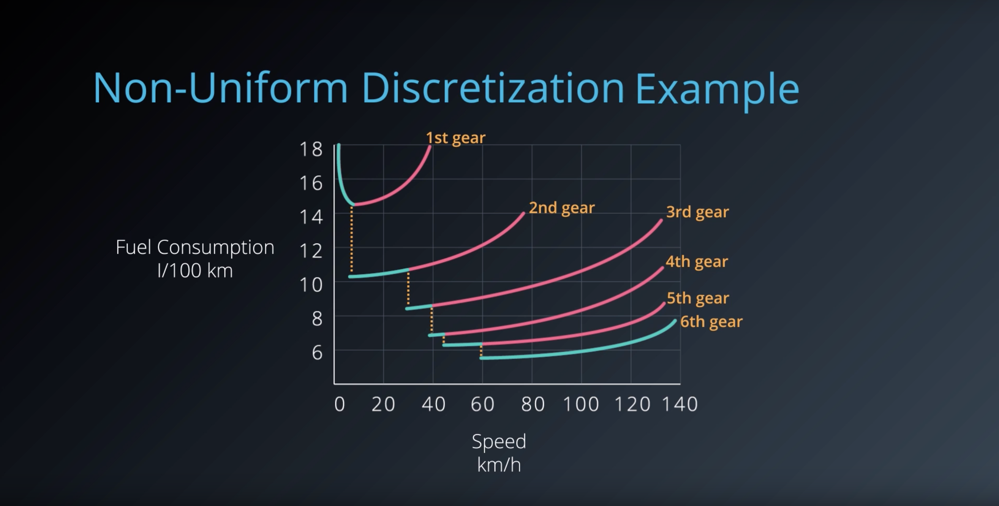

In [20]:
from IPython.display import Image
Image(filename='./images/1-6-3-6_discertization_other_non-uniform-descretization_example.png')

## 1-6-4 : Tile Coding

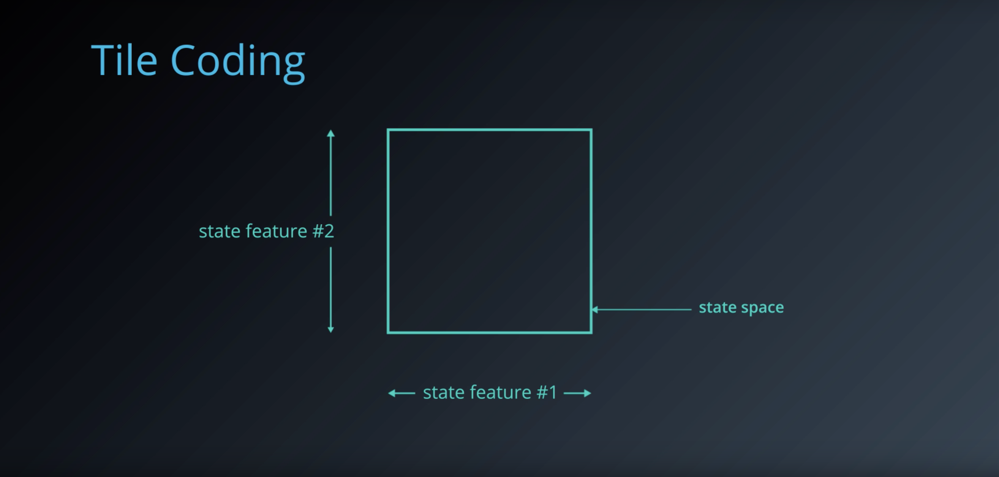

In [1]:
from IPython.display import Image
Image(filename='./images/1-6-4-1_tile-coding_state_space_is_continous_and_two_dimentional.png')

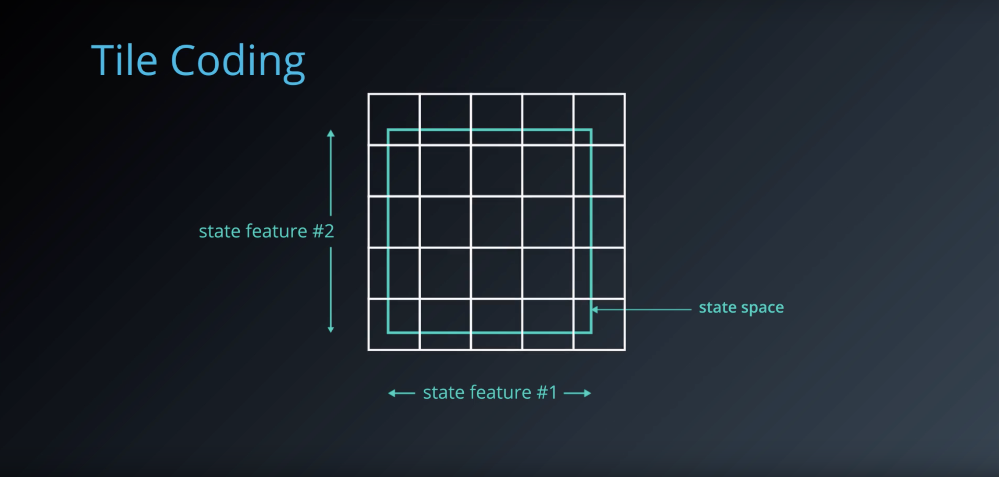

In [2]:
from IPython.display import Image
Image(filename='./images/1-6-4-2_tile-coding_overlay_multiple_tilings_on_top_of_the_space.png')

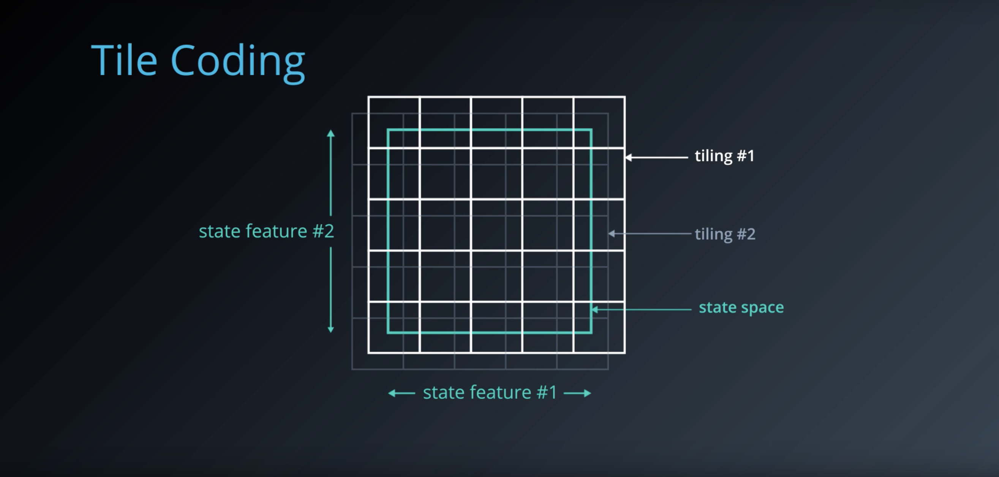

In [3]:
from IPython.display import Image
Image(filename='./images/1-6-4-3_tile-coding_each_slightly_offset_from_each_other.png')

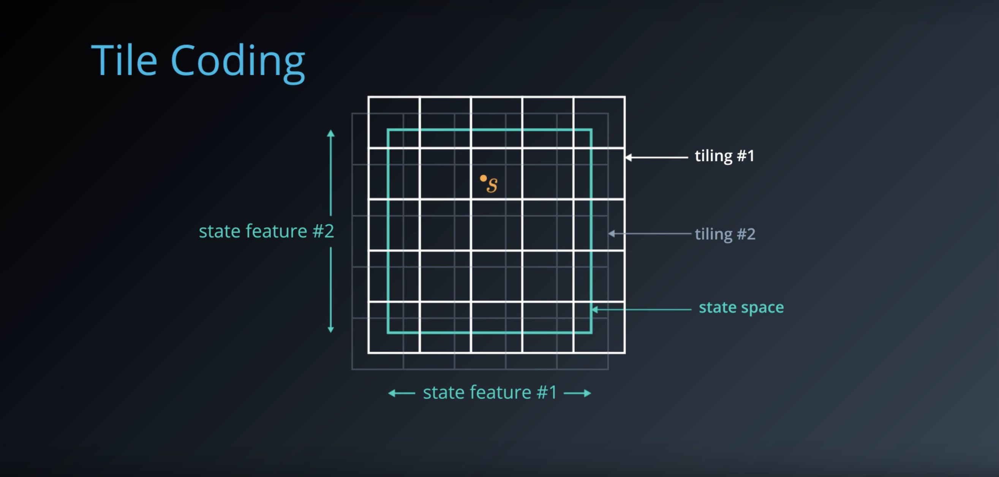

In [4]:
from IPython.display import Image
Image(filename='./images/1-6-4-4_tile-coding_position_s_is_coarsly_identified_by_the_tiles.png')

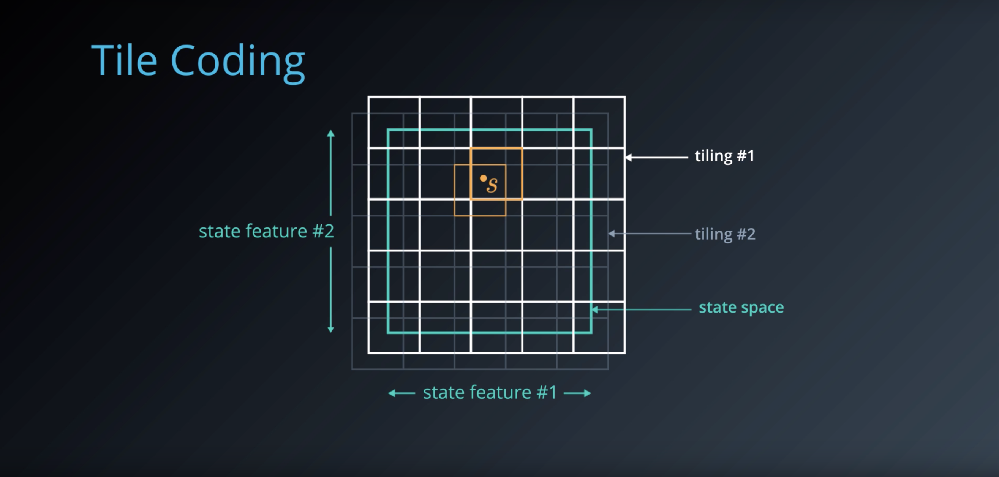

In [5]:
from IPython.display import Image
Image(filename='./images/1-6-4-5_tile-coding_it_represent_new_discretised_state_as_a_bit_vector.png')

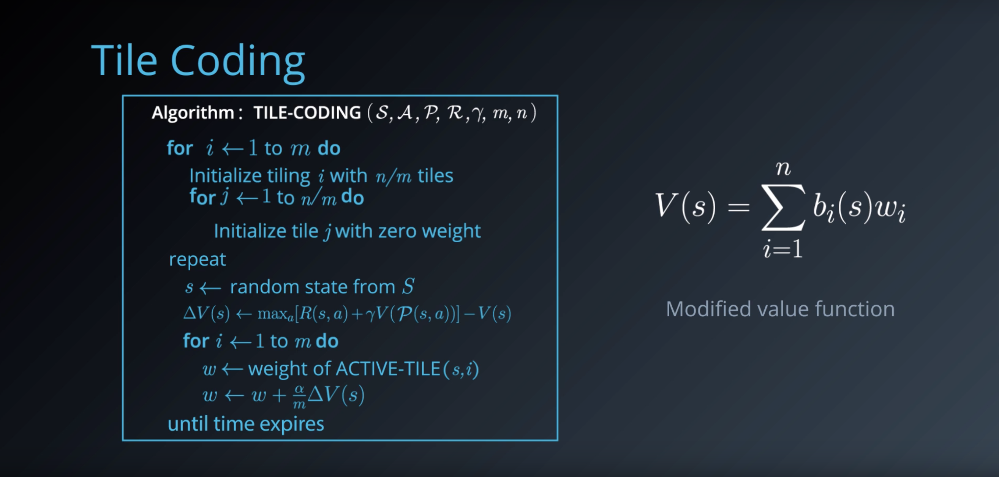

In [6]:
from IPython.display import Image
Image(filename='./images/1-6-4-6_tile-coding_algorithm.png')

#### The point is how the state value fuction is computed. 
- Instead of storing a separate value for each stave V of S, it is defined in terms of the bit vector for that state and a weight for each tile. 
- The tile coding algorithm in turn updates these weights iteratively.
- This ensures nearby loactions that share tiles also share state value.

#### Tile coding does have some drawbacks. we have to manually select the tile sizes, 

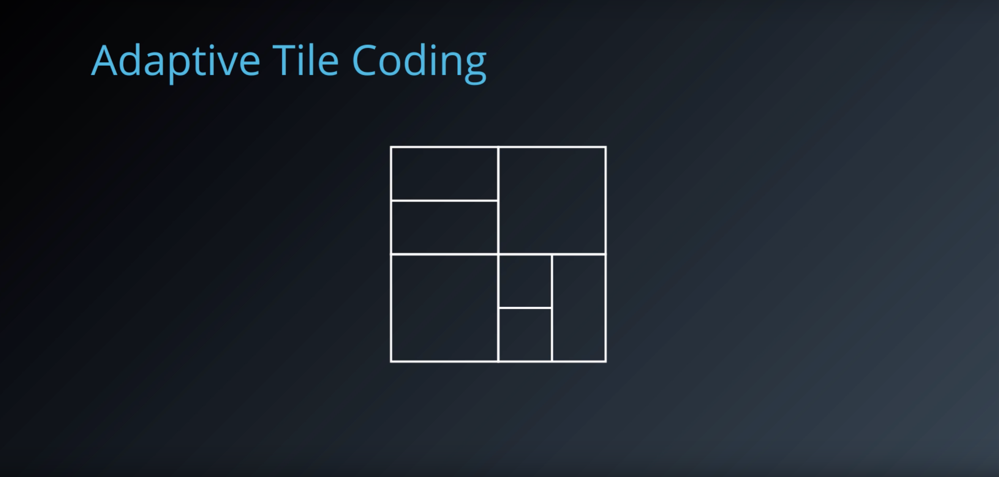

In [7]:
from IPython.display import Image
Image(filename='./images/1-6-4-7_adaptive-tile-coding.png')

#### Adaptive Tile Coding is more flexibile approach.
- It start with fairly large tiles and divides each tile into two whenever appropriate.
- Basically, we want to split the state space when we realize that we are no longer learning much with currunt representation. This is, when our value function isn't changing or some max iterations.
- In order to figure out which tile to split, we have to look at which one is likely to have the greatest effect on the value function. For this, we need to keep track of subtiles and their projected weights. Then, we can pick the title with the greatest difference between subtile weights.

#### The main advantage is that it doesn't rely on a human to specify a discretisation ahead of time.
#### The resulting state space is appropriately partitioned based on its complexity.


## 1-6-5 : Coarse Coding

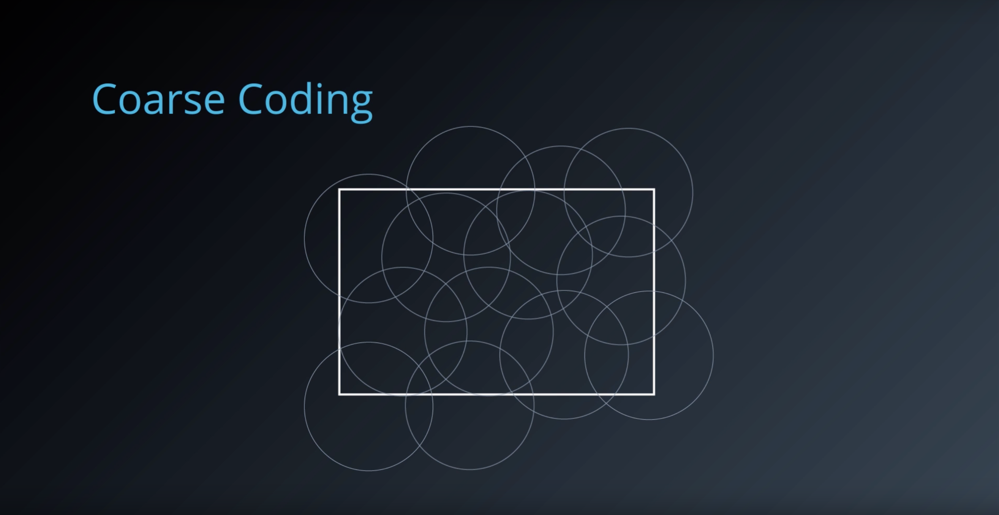

In [8]:
from IPython.display import Image
Image(filename='./images/1-6-5-1_course-coding_uses_a_sparser_set_of_features_to_encode_state_space.png')

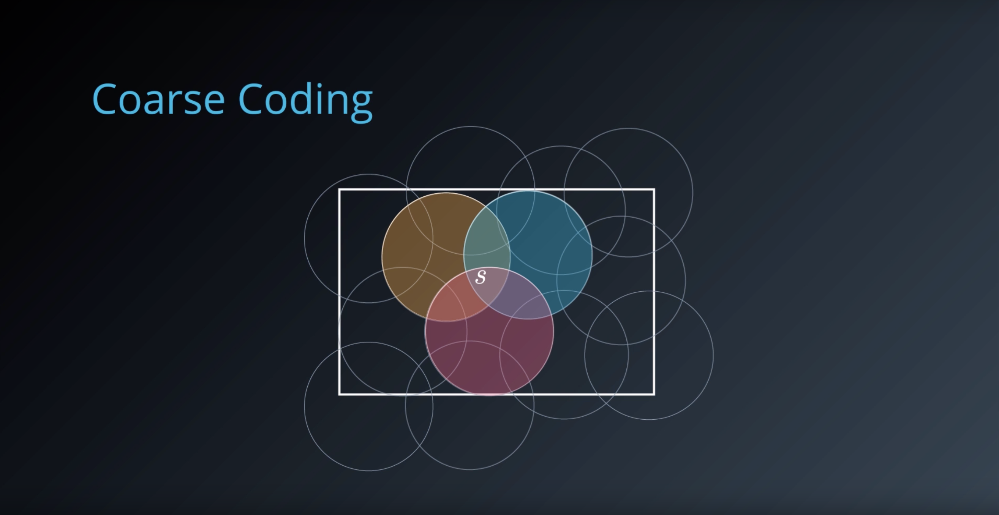

In [9]:
from IPython.display import Image
Image(filename='./images/1-6-5-2_course-coding_prepare_a_bit_vector_with_1_for_those_circles_and_0_for_the_rest.png')

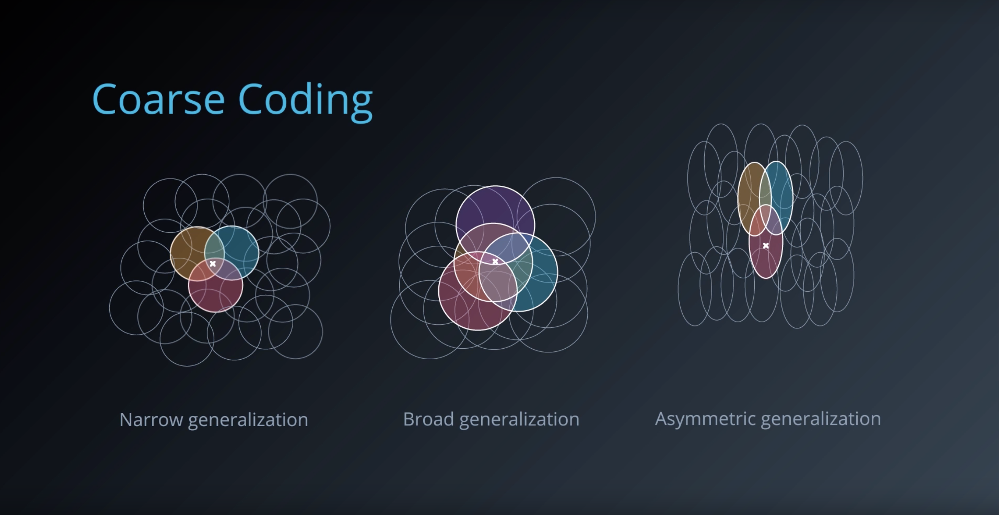

In [10]:
from IPython.display import Image
Image(filename='./images/1-6-5-3_course-coding_three_generalizations.png')

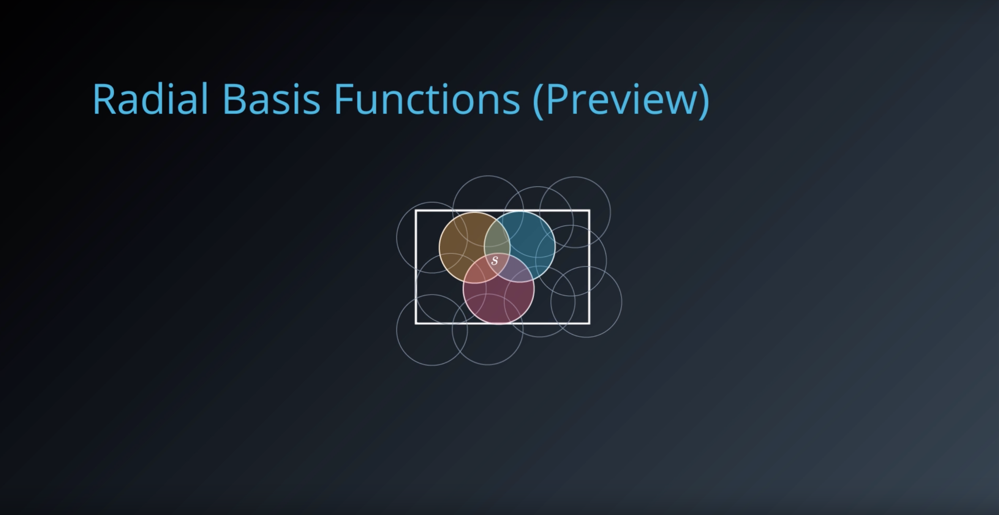

In [11]:
from IPython.display import Image
Image(filename='./images/1-6-5-4_course-coding_RadialBasisFunctions.png')

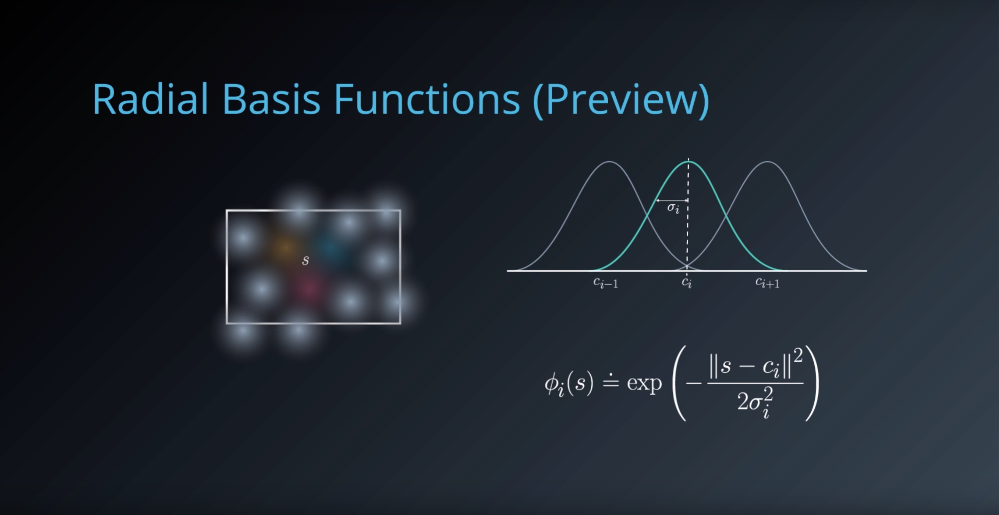

In [12]:
from IPython.display import Image
Image(filename='./images/1-6-5-5_course-coding_RadialBasisFunctions_is_cool_that_the_number_of_features_can_be_drastically_reduced.png')

## 1-6-6 : Function Approximation

So far, we've looked at ways to discretize continous state spaces.
This enables us to use existing traditional reinforcement learning algorithms with little or no modification.

#### But there are some limitations.
- When the underlying space is complicated, the number of discrete states needed can become vary very large.
- We lose the advantage of discretization.
- Moreover, if you think about positions in the state space that are nearby, you would expect their values to be similar, or smoothly changing.

#### Discertization doesn't always exploit this characteristic, failing to generalize well across the space.

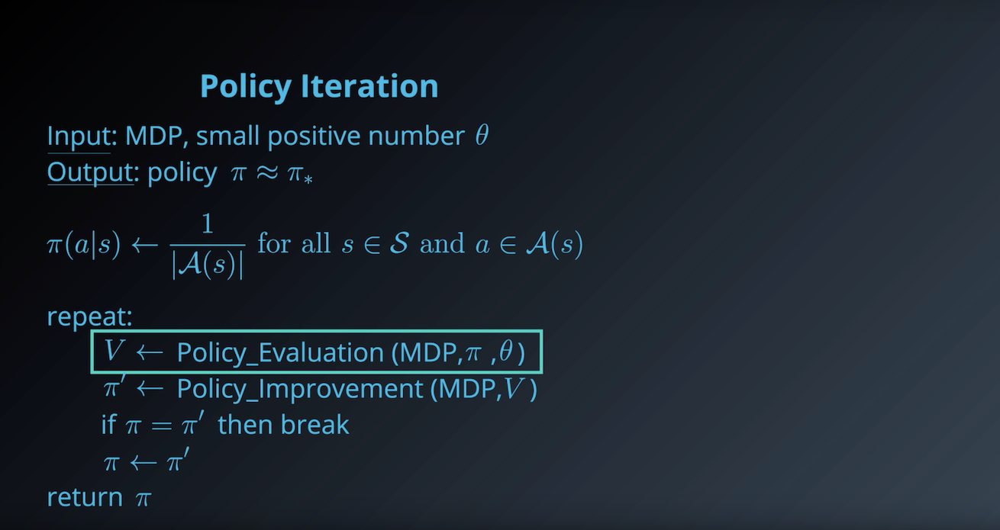

In [44]:
from IPython.display import Image
Image(filename='./images/1-3-6-1_dp_Truncated-Policy-Iteration_step1.png')

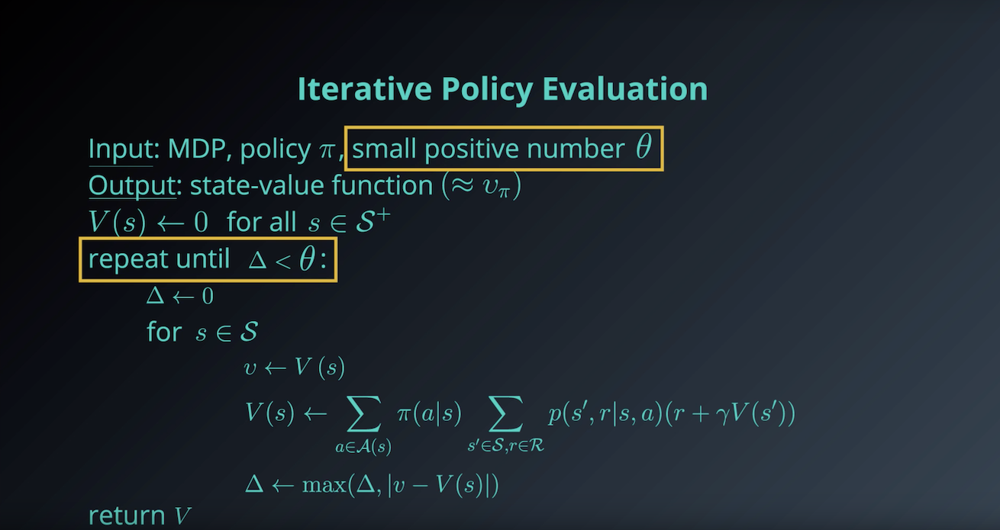

In [45]:
from IPython.display import Image
Image(filename='./images/1-3-6-2_dp_Truncated-Policy-Iteration_step2.png')

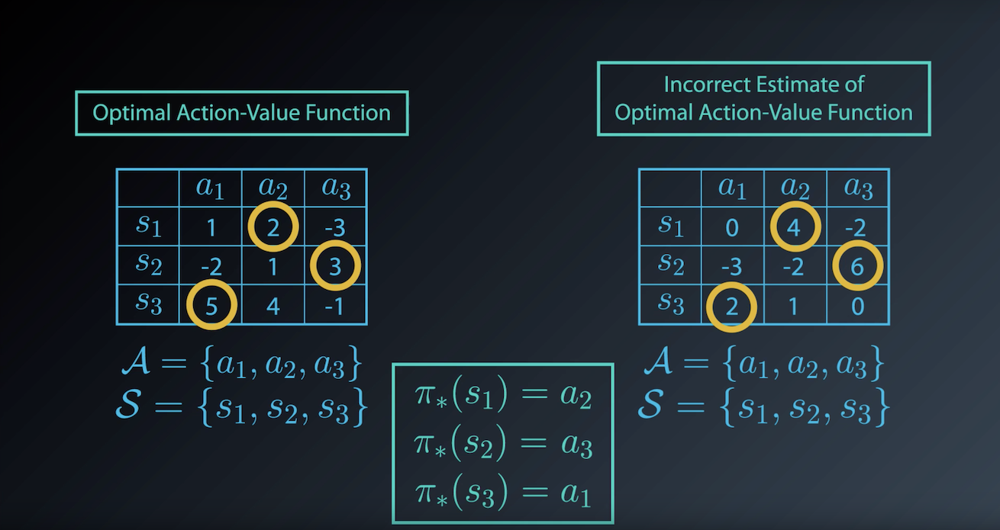

In [46]:
from IPython.display import Image
Image(filename='./images/1-3-6-3_dp_Truncated-Policy-Iteration_step3.png')

## 1-3-7 : Value Iteration

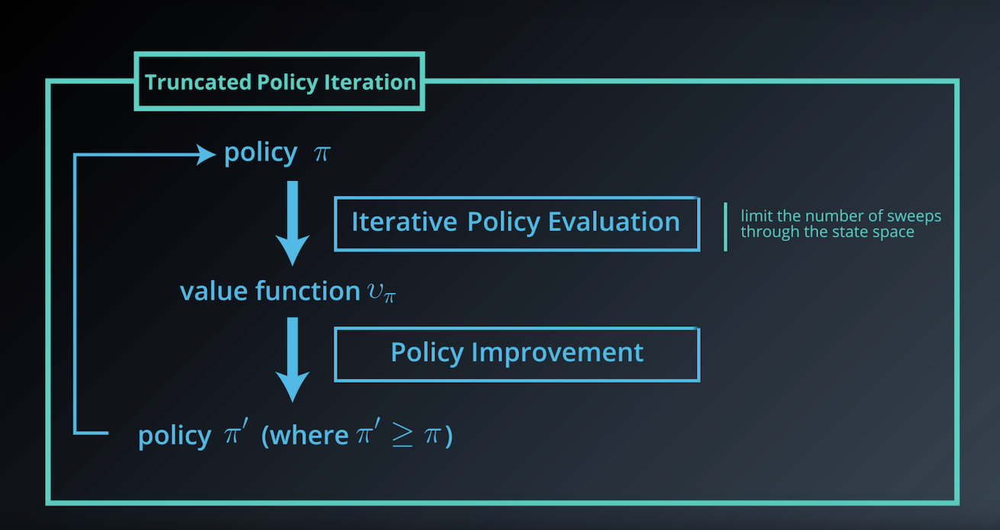

In [47]:
from IPython.display import Image
Image(filename='./images/1-3-7-1_dp_Value-Iteration_step1.png')

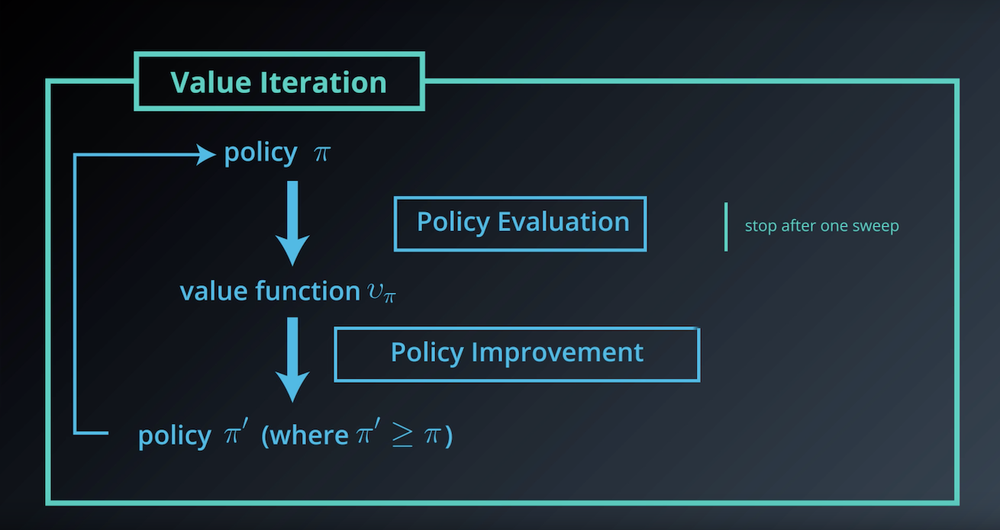

In [48]:
from IPython.display import Image
Image(filename='./images/1-3-7-2_dp_Value-Iteration_step2.png')

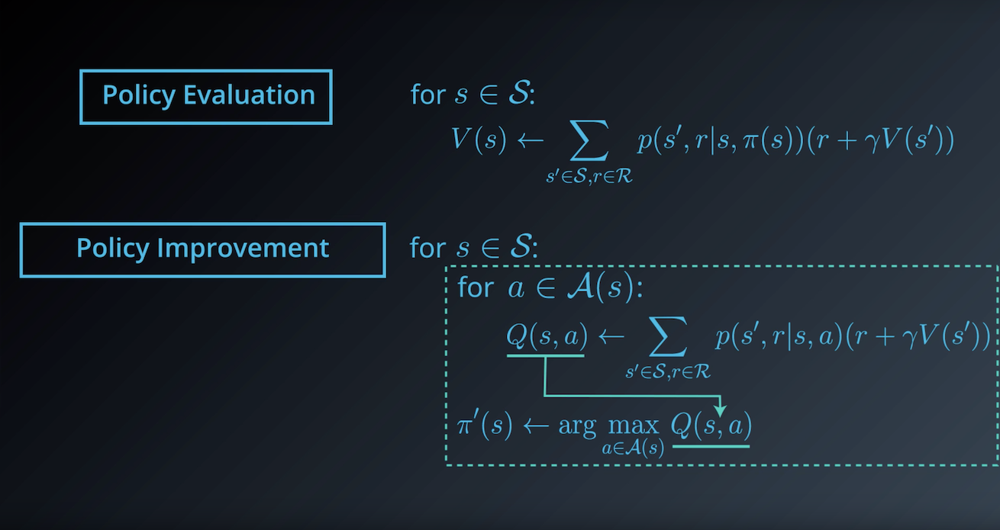

In [49]:
from IPython.display import Image
Image(filename='./images/1-3-7-3_dp_Value-Iteration_step3.png')

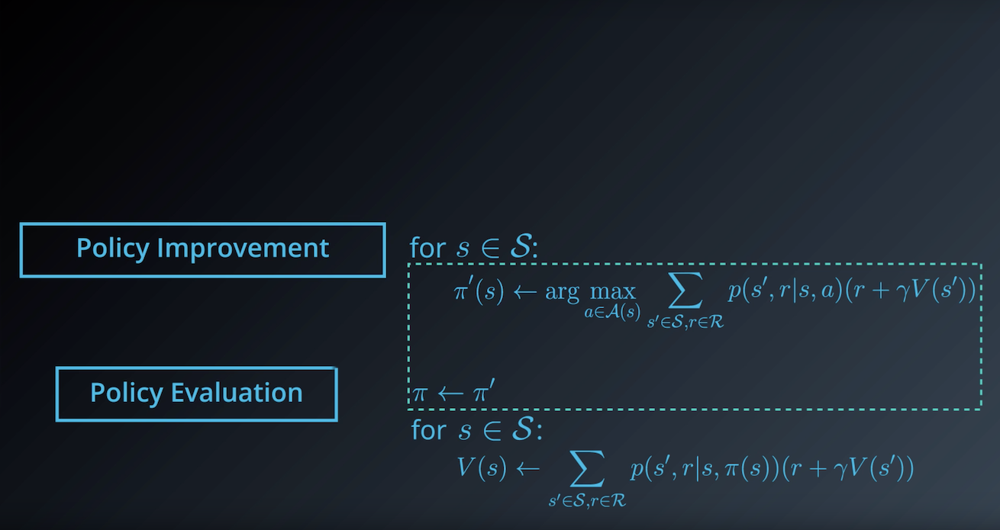

In [50]:
from IPython.display import Image
Image(filename='./images/1-3-7-4_dp_Value-Iteration_step4.png')

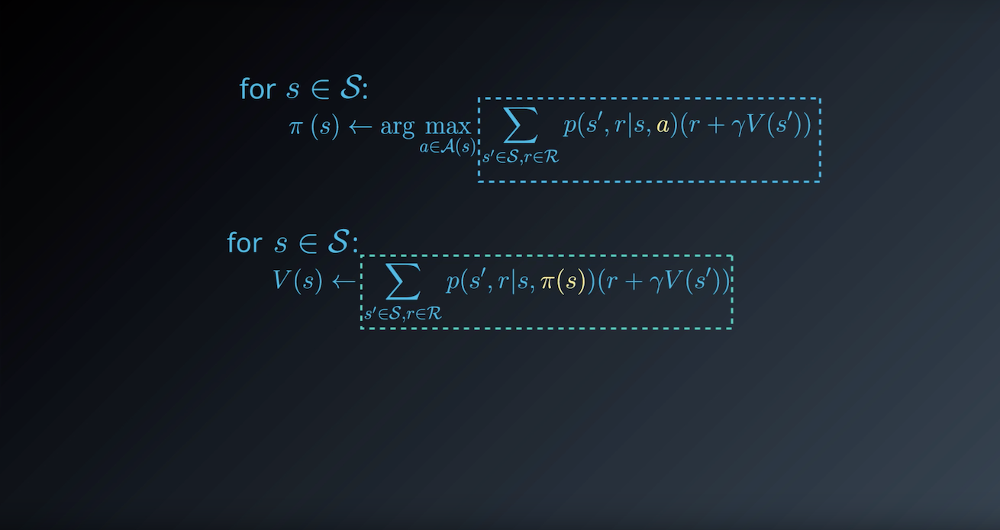

In [51]:
from IPython.display import Image
Image(filename='./images/1-3-7-5_dp_Value-Iteration_step5.png')

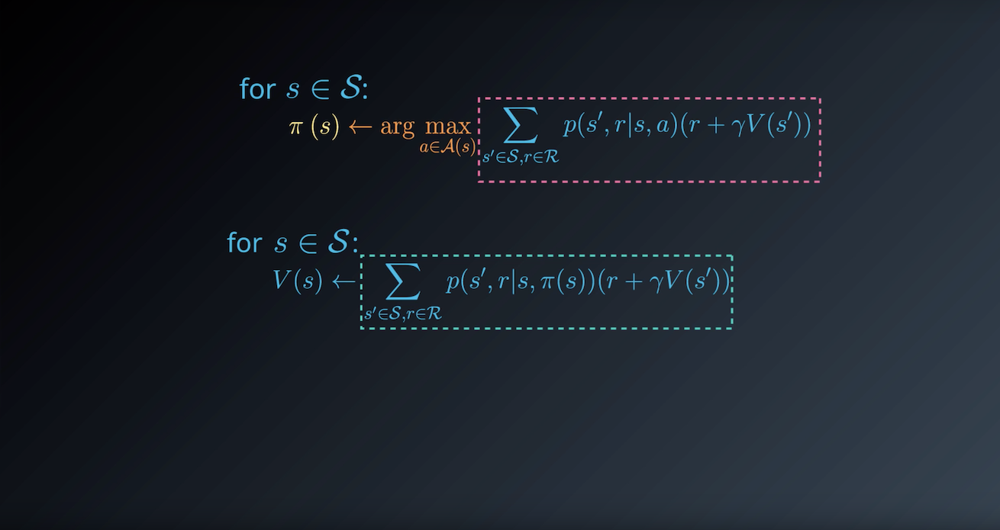

In [52]:
from IPython.display import Image
Image(filename='./images/1-3-7-6_dp_Value-Iteration_step6.png')

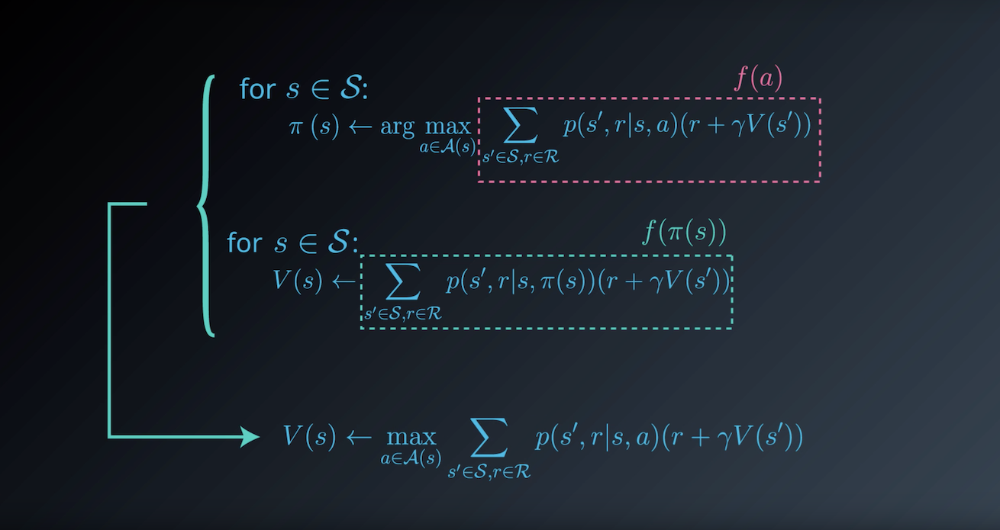

In [53]:
from IPython.display import Image
Image(filename='./images/1-3-7-7_dp_Value-Iteration_step7.png')

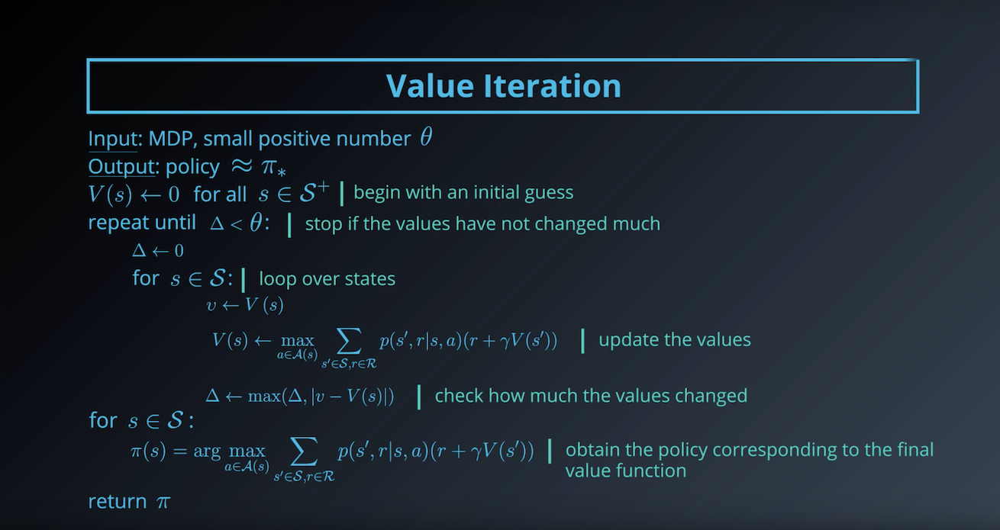

In [54]:
from IPython.display import Image
Image(filename='./images/1-3-7-8_dp_Value-Iteration_step8.png')

## 1-3-8 : Quiz : Check Your Understanding

Match each algorithm to its appropriate description.

1. Value Iteration
2. Policy Improvement
3. Policy Iteration
4. (Iterative) Policy Evaluation

### QUESTION 1 OF 4

Finds the optimal policy through successive rounds of evaluation and improvement.

### QUESTION 2 OF 4

Given a value function corresponding to a policy, proposes a better (or equal) policy.

### QUESTION 3 OF 4

Computes the value function corresponding to an arbitrary policy.

### QUESTION 4 OF 4

Finds the optimal policy through successive rounds of evaluation and improvement (where the evaluation step is stopped after a single sweep through the state space).